In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import random
import math
import pandas as pd
import xgboost
import lightgbm
import catboost

from matplotlib.colors import ListedColormap
from scipy.stats import pearsonr
from itertools import combinations
from sklearn.base import BaseEstimator
from sklearn import datasets
from sklearn.model_selection import train_test_split, GridSearchCV, KFold, RandomizedSearchCV
from sklearn.ensemble import (RandomForestClassifier,
                              ExtraTreesClassifier,
                              VotingClassifier)
from sklearn.tree import (DecisionTreeRegressor,
                          DecisionTreeClassifier)
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import cross_val_score
from sklearn.metrics import f1_score, accuracy_score
from sklearn.preprocessing import StandardScaler

from bayes_opt import BayesianOptimization

In [ ]:
plt.rcParams["figure.figsize"] = 12, 9
sns.set_style("whitegrid")
warnings.filterwarnings("ignore")

SEED = 111
random.seed(SEED)
np.random.seed(SEED)

### Задание 1. Bias-variance trade-off

**2 балла**

Продемонстрируйте bias-variance trade-off для `DecisionTreeRegressor` при изменении глубины дерева. Постройте регрессионную модель функции от одной независимой переменной, представленной в ячейке ниже, используя функцию `plot_regression_predictions` (можете ее как-то поменять, если захочется). Попробуйте разные значения глубины деревьев, при каком значении, на ваш взгляд, модель оптимальна, при каком variance становится слишком большим?

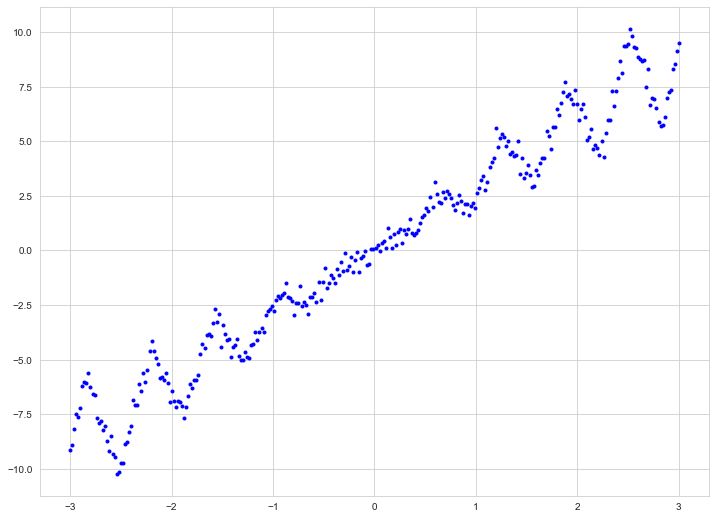

In [ ]:
# Сгенерируем какую-нибудь необычную зависимость и научимся ее предсказывать
np.random.seed(42)
m = 300
X = np.linspace(-3, 3, m).reshape(-1, 1)
y = (3 + 2/np.pi * np.arcsin(np.cos(10 * X))) * X
y = y + np.random.randn(m, 1) / 3
plt.plot(X.reshape(-1), y.reshape(-1), "b.");

In [ ]:
# Функция для отрисовки предсказаний деревьев решений в случае регрессии
def plot_regression_predictions(tree_reg, X, y, axes=[-3, 3, -10, 10], ylabel="$y$"):
    x1 = np.linspace(axes[0], axes[1], 500).reshape(-1, 1)
    y_pred = tree_reg.predict(x1)
    plt.axis(axes)
    plt.xlabel("$x_1$", fontsize=18)
    if ylabel:
        plt.ylabel(ylabel, fontsize=18, rotation=0)

    plt.plot(x1, y_pred, linewidth=2, label=r"$\hat{y}$")

Изобразите, как меняются предсказания дерева при увеличении максимальной глубины (можно взять что-то в диапазоне от 1 до 15):

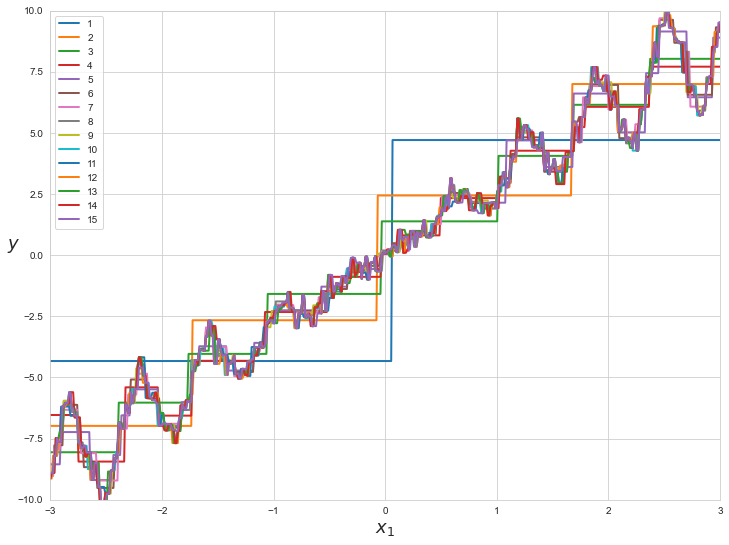

In [ ]:
for i in range(1, 16):
    X_train, X_test, y_train, y_test = train_test_split(X, y)
    tree_reg = DecisionTreeRegressor(max_depth=i, random_state=0)
    tree_reg.fit(X_train, y_train)
    plot_regression_predictions(tree_reg, X, y)

plt.legend(range(1, 16))
plt.show()

### Задание 2. Random forest

Теперь давайте немного подготовимся к тому, чтобы реализовать свой собственный случайный лес, а потом реализуем его.

#### Задание 2. 1. Простое ансамблирование

**1 балла**

Представим, что у нас есть 101 классификатор. Каждый может с вероятностью `p` (равной для всех моделей) правильно предсказать класс объекта. Будем делать предсказания по большинству голосов (majority vote). Постройте зависимость вероятности правильно классифицировать объект от значения `p`. Вам может быть полезная следующая формула:

$$ \large \mu = \sum_ {i = 51} ^ {101} C_{101} ^ ip ^ i (1-p) ^ {101-i} $$

In [ ]:
p = np.arange(0, 1.005, 0.005)
i = np.arange(51, 102, 1)
mu = 0
for j in i:
    mu += (math.factorial(101) * (p ** j) * ((1 - p) ** (101 - j)) / (math.factorial(101 - j) * math.factorial(j)))

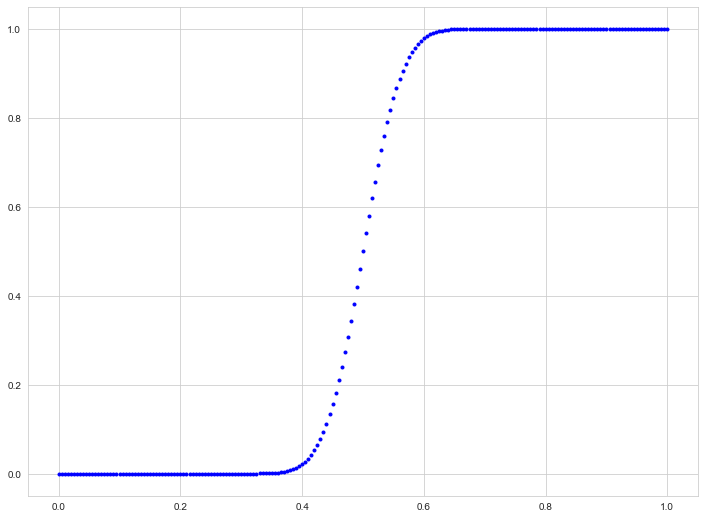

In [ ]:
plt.plot(p, mu, "b.")

А теперь давайте посмотрим на другую ситуацию. У нас есть фиксированная вероятность того, что модель правильно классифицирует объект `p = 0.65`. Постройте зависимость вероятности правильно классифицировать объект от числа моделей в ансамбле.

In [ ]:
p = 0.65
i = np.arange(3, 102, 1)
mu = np.zeros(i.shape)
for j in range(i.shape[0]):
    n = i[j]
    for k in range((n//2 + 1), n+1):
        mu[j] += (math.factorial(n) * (p ** k) * ((1 - p) ** (n - k)) / (math.factorial(n - k) * math.factorial(k)))

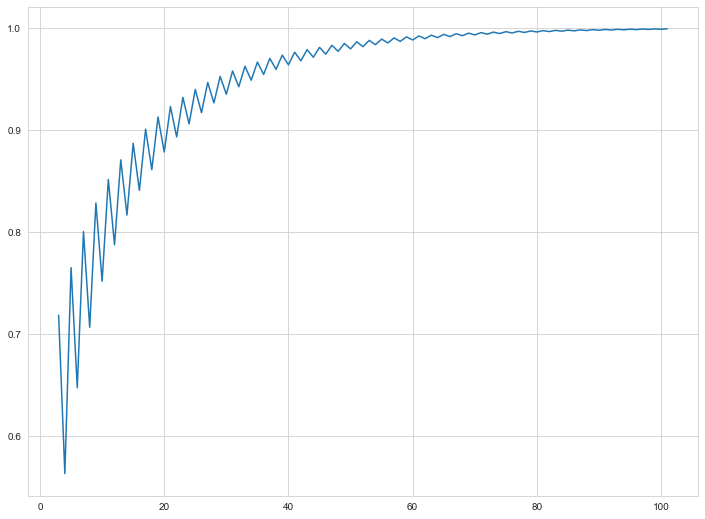

In [ ]:
plt.plot(i, mu)

Опишите ваши наблюдения:

* ансамбль из 101-го классификатора позволяет правильно предсказать класс объекта почти со 100%-ной вероятностью при вероятности правильного предсказания одного классификатора больше 0.6
* при вероятности, равной 0.65, достаточно более 20 классификаторов в ансамбле для достижения 90% точности предсказания 

#### Задание 2. 2. Реализация простого RF

**4 балла**

Реализуйте свой собственный класс `RandomForestClassifierCustom`, используя в качестве базовой модели `DecisionTreeClassifier` из `sklearn`.

Небольшое описание:
- Используйте приведенный ниже код
- В методе `fit` в цикле (`i` от 0 до `n_estimators-1`):
    * Зафиксируйте генератор случайных чисел следующим образом np.random.seed(`random_state + i`). Идея в том, что на каждой итерации у нас будет новое значение для генератора случайных чисел, что добавит побольше "случайности", но в то же время мы сможем иметь воспроизводимые результаты
    * После чего выберите `max_features` признаков **без возвращения/without replacement**, сохраните список выбранных признаков (их индексов) в `self.feat_ids_by_tree`
    * Также создайте псевдовыборку при помощи бутстрэпа (выбор **с возвращением/with replacement**) из тренировочных данных. Может помочь функция `np.random.choice` и ее аргумент `replace`
    * Обучите дерево решений с параметрами, заданными в конструкторе класса `max_depth`, `max_features` и `random_state` на полученной псевдовыборке.
- Метод `fit` должен возвращать текущий экземпляр класса `RandomForestClassifierCustom`, то есть `self` (все по-взрослому, как в `sklearn`)
- В методе `predict_proba` мы должны пройти циклом по всем деревьям. Для каждого предсказания, нам нужно будет брать только те признаки, на которых училось изначальное дерево, поэтому мы и сохраняли эту информацию в артрибуте `self.feat_ids_by_tree`. Этот метод должен возвращать предсказанные вероятности (можно делать двумя способами: для каждого дерева предсказывать значение при помощи метода `predict_proba` и потом усреднять эти вероятности, или к примеру пользоваться методом `predict` и также считать среднее.

In [ ]:
class RandomForestClassifierCustom(BaseEstimator):
    
    def __init__(self, n_estimators=10, max_depth=None, max_features=None, random_state=SEED):
        self.n_estimators = n_estimators
        self.max_depth = max_depth
        self.max_features = max_features
        self.random_state = random_state

        self.trees = []
        self.feat_ids_by_tree = []

    def fit(self, X, y):
        self.classes_ = sorted(np.unique(y))
        
        for i in range(self.n_estimators):
            np.random.seed(self.random_state + i)
            self.feat_ids_by_tree = np.random.choice(X.shape[1], self.max_features, replace=False)
            bootstrap_train_ids = np.random.choice(X.shape[0], X.shape[0], replace=True)
            bootstrap_train_X = X[np.ix_(bootstrap_train_ids, self.feat_ids_by_tree)]
            bootstrap_train_y = y[bootstrap_train_ids]
            
            clf = DecisionTreeClassifier(max_depth=self.max_depth,
                                     max_features=self.max_features,
                                     random_state=self.random_state)
            clf.fit(bootstrap_train_X, bootstrap_train_y)
            
            self.trees.append(clf)
        
        return self

    def predict_proba(self, X):
        y_prob = []
        i = 0
        for tree in self.trees:
            y_prob.append(tree.predict_proba(X[:, self.feat_ids_by_tree]))
            i += 1
        
        return np.array(y_prob).mean(axis=0)
    
    def predict(self, X):
        probas = self.predict_proba(X)
        predictions = np.argmax(probas, axis=1)
        
        return predictions

Протестируем нашу реализацию на искусственных данных. Визуализируйте разделяющую границу, которую рисует ваша модель при помощи функции `plot_decision_boundary` (см. примеры в лекции).

In [ ]:
def plot_decision_boundary(clf, X, y, axes=[-1.5, 2.5, -1, 1.5], alpha=0.5, contour=True):
    x1s = np.linspace(axes[0], axes[1], 100)
    x2s = np.linspace(axes[2], axes[3], 100)
    x1, x2 = np.meshgrid(x1s, x2s)
    X_new = np.c_[x1.ravel(), x2.ravel()]
    y_pred = clf.predict(X_new).reshape(x1.shape)
    custom_cmap = ListedColormap(["#ffdab9","#9898ff", "#4B0082"])
    plt.contourf(x1, x2, y_pred, alpha=0.3, cmap=custom_cmap)
    if contour:
        custom_cmap2 = ListedColormap(["#ffdab9", "#4c4c7f", "#4B0082"])
        plt.contour(x1, x2, y_pred, cmap=custom_cmap2, alpha=0.8)
    plt.plot(X[:, 0][y==0], X[:, 1][y==0], "yo", alpha=alpha)
    plt.plot(X[:, 0][y==1], X[:, 1][y==1], "bs", alpha=alpha)
    plt.axis(axes)
    plt.xlabel(r"$x_1$", fontsize=18)
    plt.ylabel(r"$x_2$", fontsize=18, rotation=0)

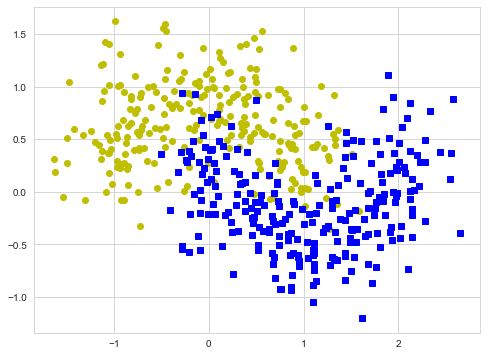

In [ ]:
X, y = datasets.make_moons(n_samples=500, noise=0.30, random_state=SEED)

plt.figure(figsize=(8, 6))
plt.plot(X[:, 0][y==0], X[:, 1][y==0], "yo")
plt.plot(X[:, 0][y==1], X[:, 1][y==1], "bs")
plt.show()

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=SEED)

In [ ]:
my_random_forest = RandomForestClassifierCustom(n_estimators=10, max_depth=10, max_features=2)
my_random_forest.fit(X_train, y_train)

RandomForestClassifierCustom(max_depth=10, max_features=2)

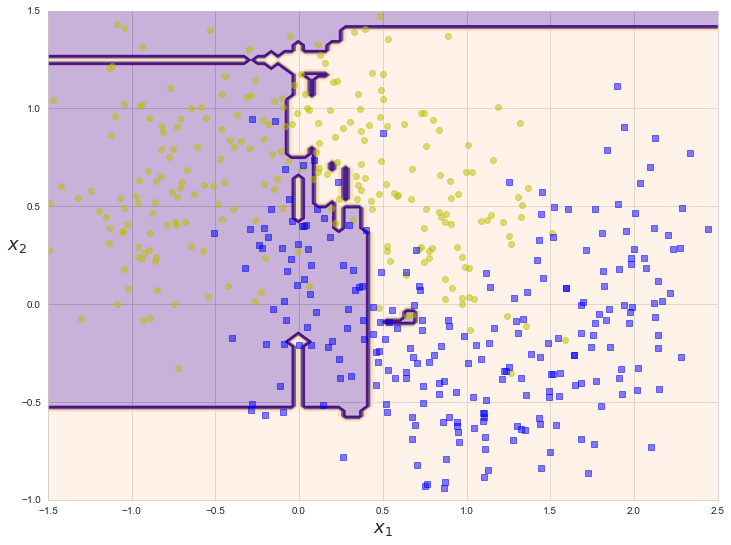

In [ ]:
plot_decision_boundary(my_random_forest, X, y)

Подберите наилучшие гиперпараметры, при которых разделяющая граница будет, на ваш взгляд, оптимальной с точки зрения bias-variance. Можно также подключить какие-то метрики для выбора лучшей модели.

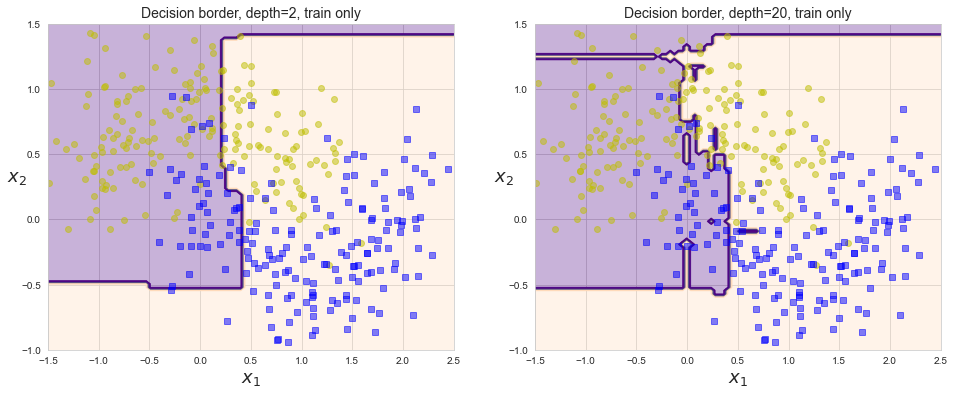

In [ ]:
#сравним глубину
clf1 = RandomForestClassifierCustom(n_estimators=10, max_depth=2, max_features=2)
clf1.fit(X_train, y_train)

clf2 = RandomForestClassifierCustom(n_estimators=10, max_depth=20, max_features=2)
clf2.fit(X_train, y_train)

plt.figure(figsize=(16, 6))
plt.subplot(121)
plot_decision_boundary(clf1, X_train, y_train)
plt.title("Decision border, depth=2, train only", fontsize=14)
plt.subplot(122)
plot_decision_boundary(clf2, X_train, y_train)
plt.title("Decision border, depth=20, train only", fontsize=14)
plt.show()

Выглядит плохо, попробуем добавить деревья в лес:

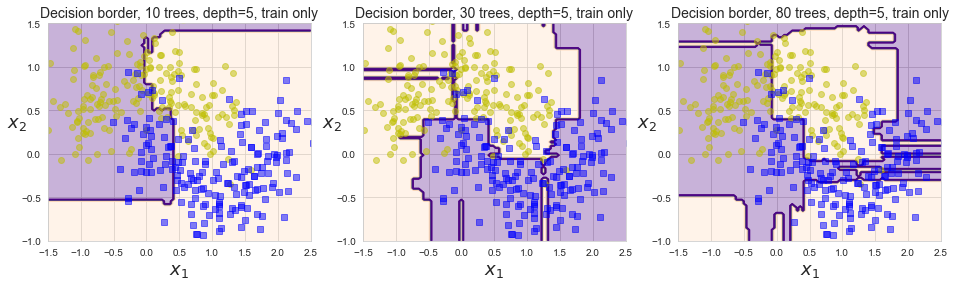

In [ ]:
#сравним количество деревьев
clf1 = RandomForestClassifierCustom(n_estimators=10, max_depth=5, max_features=2)
clf1.fit(X_train, y_train)

clf2 = RandomForestClassifierCustom(n_estimators=30, max_depth=5, max_features=2)
clf2.fit(X_train, y_train)

clf3 = RandomForestClassifierCustom(n_estimators=80, max_depth=5, max_features=2)
clf3.fit(X_train, y_train)

plt.figure(figsize=(16, 4))
plt.subplot(131)
plot_decision_boundary(clf1, X_train, y_train)
plt.title("Decision border, 10 trees, depth=5, train only", fontsize=14)
plt.subplot(132)
plot_decision_boundary(clf2, X_train, y_train)
plt.title("Decision border, 30 trees, depth=5, train only", fontsize=14)
plt.subplot(133)
plot_decision_boundary(clf3, X_train, y_train)
plt.title("Decision border, 80 trees, depth=5, train only", fontsize=14)
plt.show()

80 - явно перебор, 30 похоже на правду

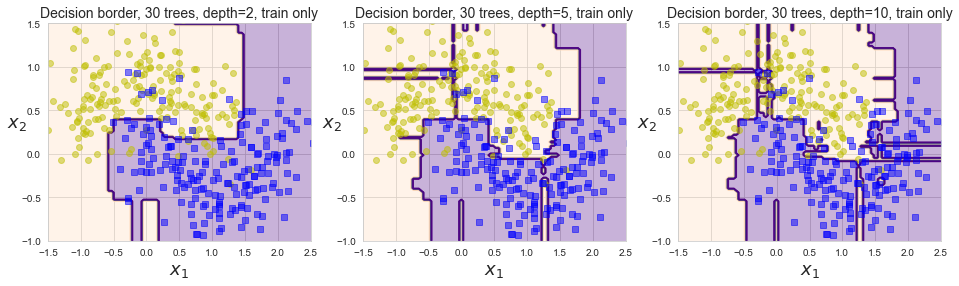

In [ ]:
#сравним глубину для 30 деревьев
clf1 = RandomForestClassifierCustom(n_estimators=30, max_depth=2, max_features=2)
clf1.fit(X_train, y_train)

clf2 = RandomForestClassifierCustom(n_estimators=30, max_depth=5, max_features=2)
clf2.fit(X_train, y_train)

clf3 = RandomForestClassifierCustom(n_estimators=30, max_depth=10, max_features=2)
clf3.fit(X_train, y_train)

plt.figure(figsize=(16, 4))
plt.subplot(131)
plot_decision_boundary(clf1, X_train, y_train)
plt.title("Decision border, 30 trees, depth=2, train only", fontsize=14)
plt.subplot(132)
plot_decision_boundary(clf2, X_train, y_train)
plt.title("Decision border, 30 trees, depth=5, train only", fontsize=14)
plt.subplot(133)
plot_decision_boundary(clf3, X_train, y_train)
plt.title("Decision border, 30 trees, depth=10, train only", fontsize=14)
plt.show()

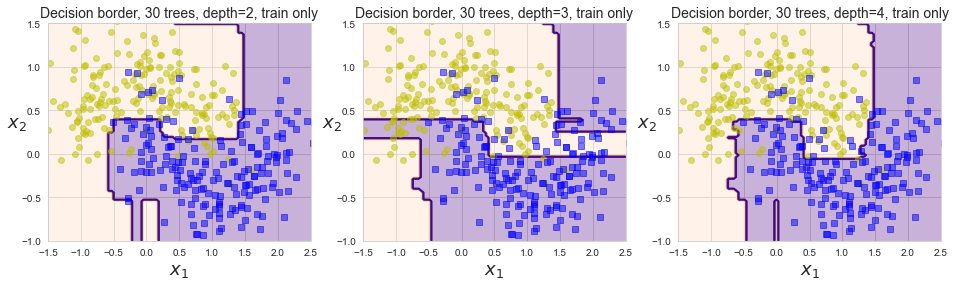

In [ ]:
#сравним глубину для 30 деревьев
clf1 = RandomForestClassifierCustom(n_estimators=30, max_depth=2, max_features=2)
clf1.fit(X_train, y_train)

clf2 = RandomForestClassifierCustom(n_estimators=30, max_depth=3, max_features=2)
clf2.fit(X_train, y_train)

clf3 = RandomForestClassifierCustom(n_estimators=30, max_depth=4, max_features=2)
clf3.fit(X_train, y_train)

plt.figure(figsize=(16, 4))
plt.subplot(131)
plot_decision_boundary(clf1, X_train, y_train)
plt.title("Decision border, 30 trees, depth=2, train only", fontsize=14)
plt.subplot(132)
plot_decision_boundary(clf2, X_train, y_train)
plt.title("Decision border, 30 trees, depth=3, train only", fontsize=14)
plt.subplot(133)
plot_decision_boundary(clf3, X_train, y_train)
plt.title("Decision border, 30 trees, depth=4, train only", fontsize=14)
plt.show()

В общем и целом, 30 деревьев с глубиной 4 выглядят достойно! :)

Fitting DT
Fitting RF3
Fitting RF5
Fitting RF10
Fitting RF30
Fitting RF50
Fitting RF100
Fitting RF150
Fitting RF250
Calculating f1 score for DT
Calculating f1 score for RF3
Calculating f1 score for RF5
Calculating f1 score for RF10
Calculating f1 score for RF30
Calculating f1 score for RF50
Calculating f1 score for RF100
Calculating f1 score for RF150
Calculating f1 score for RF250


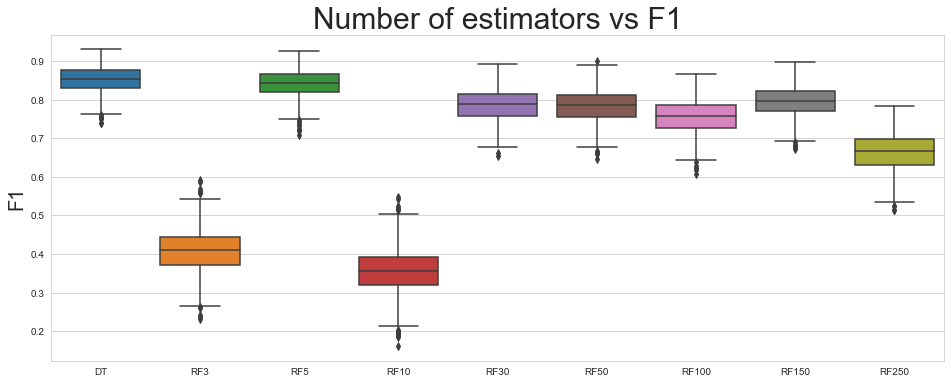

In [ ]:
# я тут воспользовалась кодом с лекции, но не стала убирать функцию бутстрепа, потому что переделывать было долго
# (я немножно попыталась, но быстро сдалась со всеми этими словарями и датафреймами вместе...)

def bootstrap_metric(x,
                     y,
                     metric_fn,
                     samples_cnt=1000,
                     alpha=0.05,
                     random_state=42):
    size = len(x)
    
    np.random.seed(random_state)
    b_metric = np.zeros(samples_cnt)
    for it in range(samples_cnt):
        poses = np.random.choice(x.shape[0], size=x.shape[0], 
                                 replace=True)
        
        x_boot = x[poses]
        y_boot = y[poses]
        
        m_val = metric_fn(x_boot, y_boot)
        b_metric[it] = m_val
    
    return b_metric

def train_and_test_classifier(models, X_train, y_train, X_test, y_test):
    for name, model in models.items():
        print(f"Fitting {name}")
        model.fit(X_train, y_train)
    predictions = {}
    for name, model in models.items():
        y_pred = model.predict(X_test)
        predictions[name] = y_pred
        
    boot_scores = {}

    for name, y_pred in predictions.items():
        print(f"Calculating f1 score for {name}")
        boot_score = bootstrap_metric(y_test, 
                                      y_pred, 
                                      metric_fn=lambda x, y: f1_score(y_true=x, y_pred=y))
        boot_scores[name] = boot_score
        
    
    results = pd.DataFrame(boot_scores)
    results = results.melt(value_vars=results.columns, value_name="f1_score", var_name="model")
    
    return results

models_rf = {}
models_rf["DT"] =  DecisionTreeClassifier(max_depth=10)

for n_estimators in [3, 5, 10, 30, 50, 100, 150, 250]:
    models_rf[f"RF{n_estimators}"] = RandomForestClassifierCustom(n_estimators=n_estimators,
                                                                  max_depth=10,
                                                                  max_features=2)

results_rf = train_and_test_classifier(models_rf, X_train, y_train, X_test, y_test)

plt.figure(figsize=(16,6))
sns.boxplot(data=results_rf, y="f1_score", x='model')
plt.xlabel("", size=20)
plt.ylabel("F1", size=20)
plt.title("Number of estimators vs F1", size=30)
plt.show()

Fitting DT
Fitting RF3
Fitting RF5
Fitting RF10
Fitting RF30
Fitting RF50
Fitting RF100
Fitting RF150
Fitting RF250
Calculating accuracy for DT
Calculating accuracy for RF3
Calculating accuracy for RF5
Calculating accuracy for RF10
Calculating accuracy for RF30
Calculating accuracy for RF50
Calculating accuracy for RF100
Calculating accuracy for RF150
Calculating accuracy for RF250


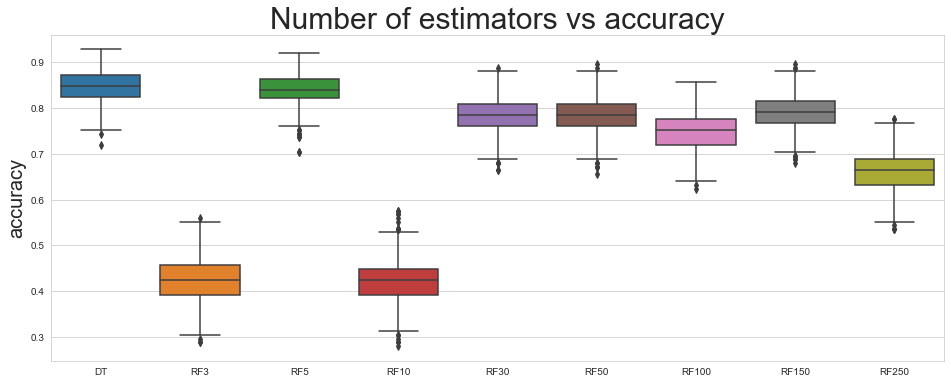

In [ ]:
def train_and_test_classifier(models, X_train, y_train, X_test, y_test):
    for name, model in models.items():
        print(f"Fitting {name}")
        model.fit(X_train, y_train)
    predictions = {}
    for name, model in models.items():
        y_pred = model.predict(X_test)
        predictions[name] = y_pred
        
    boot_scores = {}

    for name, y_pred in predictions.items():
        print(f"Calculating accuracy for {name}")
        boot_score = bootstrap_metric(y_test, 
                                      y_pred, 
                                      metric_fn=lambda x, y: accuracy_score(y_true=x, y_pred=y))
        boot_scores[name] = boot_score
        
    
    results = pd.DataFrame(boot_scores)
    results = results.melt(value_vars=results.columns,
                           value_name="accuracy", 
                           var_name="model")
    
    return results

models_rf = {}
models_rf["DT"] =  DecisionTreeClassifier(max_depth=10)

for n_estimators in [3, 5, 10, 30, 50, 100, 150, 250]:
    models_rf[f"RF{n_estimators}"] = RandomForestClassifierCustom(n_estimators=n_estimators,
                                                                  max_depth=10,
                                                                  max_features=2)

results_rf = train_and_test_classifier(models_rf, X_train, y_train, X_test, y_test)

plt.figure(figsize=(16,6))
sns.boxplot(data=results_rf, y="accuracy", x='model')
plt.xlabel("", size=20)
plt.ylabel("accuracy", size=20)
plt.title("Number of estimators vs accuracy", size=30)
plt.show()

Получается, что и одно дерево справляется даже лучше, чем лес...

#### Задание 2. 3. Корреляция базовых моделей

**3 балла**

Как мы выянили на лекции, для того, чтобы bagging работал хорошо, предсказания наших моделей не должны сильно коррелировать. Для этого в случайном лесе применяются различные подходы, в том числе и RSM. Давайте посмотрим, как влияет параметр `max_features` на корреляцию базовых моделей в случайном лесу из `sklearn`. В качестве примера будем использовать датасет `breast_cancer`. Для расчета корреляций используйте приведенную ниже функцию `base_model_pair_correlation`. Для каждой модели у вас будет получаться набор значений (попарные корреляции всех деревьев), дальше можно изобразить их в виде боксплотов, как мы на лекции рисовали распределение метрик.

In [ ]:
# Функция для расчета попарных корреляций базовых моделей в случайном лесу
def base_model_pair_correlation(ensemble, X):
    corrs = []
    for (i, est1), (j, est2) in combinations(enumerate(ensemble.estimators_), 2):
        Xi_test = X
        Xj_test = X

        ypred_t1 = est1.predict_proba(Xi_test)[:, 1]
        ypred_t2 = est2.predict_proba(Xj_test)[:, 1]

        corrs.append(pearsonr(ypred_t1, ypred_t2)[0])
    return np.array(corrs)

In [ ]:
# Загрузим данные
breast_cancer = datasets.load_breast_cancer()
X = breast_cancer.data
y = breast_cancer.target
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

Теперь давайте посмотрим, как на это влияет параметр `max_depth`:

In [ ]:
correlations = []
max_depth_range = [2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20, 30, 50, 100]
for max_depth in max_depth_range:
    random_forest = RandomForestClassifier(max_depth=max_depth)
    random_forest.fit(X_train, y_train)
    correlations.append(base_model_pair_correlation(random_forest, X_test))

result = pd.DataFrame({'max_depth': max_depth_range, 'correlations': correlations})
result = result.explode('correlations').reset_index(drop=True)

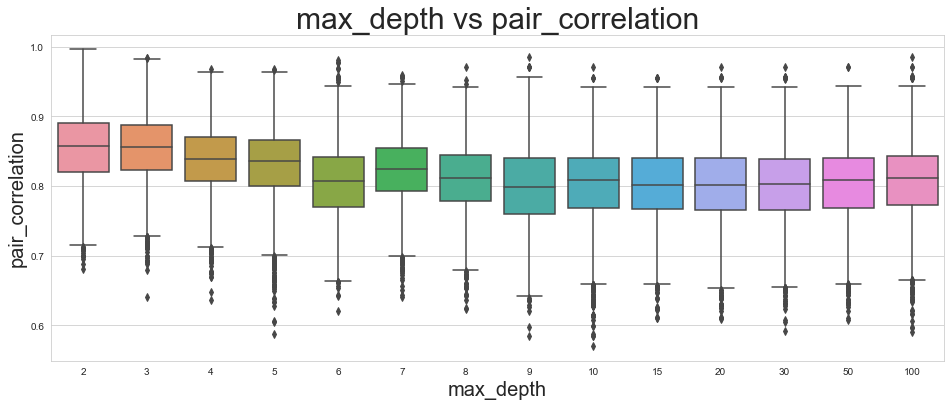

In [ ]:
plt.figure(figsize=(16,6))
sns.boxplot(data=result, x='max_depth', y='correlations')
plt.xlabel("max_depth", size=20)
plt.ylabel("pair_correlation", size=20)
plt.title("max_depth vs pair_correlation", size=30)
plt.show()

Опишите ваши наблюдения:

* в целом, модели с меньшей глубиной коррелируют больше, но тенденция не очень очевидная

### Задание 3. Строим большой ансамбль

**4 балла + 3 дополнительных за скор выше 0.89**

В данной задаче вам нужно диагностировать сердечное заболевание у людей по [медицинским показателям](https://www.kaggle.com/ronitf/heart-disease-uci).

In [ ]:
!gdown --id 1VFbDK-Ad-hpf0_GGCBzn4thdn9mkQ-Y- -O heart.csv -q

In [ ]:
heart_dataset = pd.read_csv("heart.csv")

In [ ]:
X = heart_dataset.drop("target", axis=1)
y = heart_dataset["target"]
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=SEED)
X_train.head()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal
178,43,1,0,120,177,0,0,120,1,2.5,1,0,3
298,57,0,0,140,241,0,1,123,1,0.2,1,0,3
201,60,1,0,125,258,0,0,141,1,2.8,1,1,3
246,56,0,0,134,409,0,0,150,1,1.9,1,2,3
153,66,0,2,146,278,0,0,152,0,0.0,1,1,2


Обучите разнообразные классификаторы, приведенные ниже, а также ансамбль `VotingClassifier` из `sklearn.ensemble`, объединяющий эти классификаторы с помощью жесткого или мякого голосования (параметр `voting =` `'hard'` или `'soft'` соответственно). Оцените качество моделей с помощью кросс-валидации на тренировочном наборе, используя функцию `cross_val_score` и метрику `f1`. Часть моделей отсюда мы не проходили, о них можно почитать дополнительно, но в принципе для задания не очень важно знать принципы их работы (но, если есть время, то почитайте, там интересно).

In [ ]:
dt = DecisionTreeClassifier(random_state=SEED, max_depth=10, min_samples_leaf=10)
rf = RandomForestClassifier(n_estimators=50, random_state=SEED)
etc = ExtraTreesClassifier(random_state=SEED)
knn = KNeighborsClassifier(n_neighbors=5, weights="distance")
svc_lin = SVC(kernel='linear', probability=True, random_state=SEED)
svc_rbf = SVC(kernel='rbf', probability=True, random_state=SEED)
cat = catboost.CatBoostClassifier(verbose=0, random_seed=SEED)
lgbm = lightgbm.LGBMClassifier(random_state=SEED)
lgbm_rf = lightgbm.LGBMClassifier(boosting_type="rf", bagging_freq=1, bagging_fraction=0.7, random_state=SEED)
xgb = xgboost.XGBClassifier(random_state=SEED)
xgb_rf = xgboost.XGBRFClassifier(random_state=SEED)
lr = LogisticRegression(solver='liblinear', max_iter=10000)
nb = GaussianNB()

base_models = [("DT", dt), ("RF", rf), 
               ("ETC", etc), ("KNN", knn), 
               ("SVC_LIN", svc_lin), ("SVC_RBF", svc_rbf), 
               ("CAT", cat), ("LGBM", lgbm), 
               ("LGBM_RF", lgbm_rf), ("XGB", xgb), 
               ("XGB_RF", xgb_rf), ("LR", lr), ("NB", nb)]

Здесь могут возникать различные предупреждения при обучении бустингов, не волнуйтесь, все нормально, просто они обычно очень разговорчивые)

In [ ]:
voting_hard = VotingClassifier(estimators=base_models, voting='hard')
voting_soft = VotingClassifier(estimators=base_models, voting='soft')

for model in [dt, rf, cat, etc, knn, svc_lin, svc_rbf, xgb, lgbm, xgb_rf, lgbm_rf, lr, nb, voting_hard, voting_soft]: 
    scores = cross_val_score(model, X_train, y_train, cv=3, scoring="f1")
    print(f"{model.__class__.__name__}: {scores.mean()}")

DecisionTreeClassifier: 0.797997226792219
RandomForestClassifier: 0.8328751280279528
CatBoostClassifier: 0.8342715174922052
ExtraTreesClassifier: 0.828174603174603
KNeighborsClassifier: 0.6493313763861709
SVC: 0.8403098469098905
SVC: 0.6973119072190279
XGBClassifier: 0.8380318868123746
LGBMClassifier: 0.8129461544095692
XGBRFClassifier: 0.8488204901143478
LGBMClassifier: 0.8101597492003888
LogisticRegression: 0.8500073681108163
GaussianNB: 0.8140676625250128
VotingClassifier: 0.8490813069126322
VotingClassifier: 0.8583484026522002


Вы можете заметить, что ансамбль показывает хорошее, но не лучшее качество предсказания, попробуем его улучшить. Как вы знаете, ансамбли работают лучше, когда модели, входящие в них не скоррелированы друг с другом. Определите корреляцию предсказаний базовых моделей в ансамбле на тестовом наборе данных, и удалите из ансамбля те модели, чьи предсказания будут сильнее коррелировать с остальными. Воспользуйтесь функцией `base_model_pair_correlation_for_voting_clf`. **Спойлер**: далеко не факт, что если вы удалите две модели с корреляцией 0.95, то все станет сильно лучше, здесь все будет немного сложнее. Чтобы добиться максимального качества может понадобиться долгий перебор различных комбинаций моделей. Наилучший скор, который мне удалось достичь, это 0.915, но он получен весьма странной комбинацией алгоритмов, а еще и простым перебором всех вариантов)

In [ ]:
def base_model_pair_correlation_for_voting_clf(ensemble, X):
    corrs = []
    base_model_names = [f"{est.__class__.__name__}" for est in ensemble.estimators_]
    for (i, est1), (j, est2) in combinations(enumerate(ensemble.estimators_), 2):
        Xi_test = X
        Xj_test = X

        if not isinstance(est1, SVC):
            ypred_t1 = est1.predict_proba(Xi_test)[:, 1]
        else:
            ypred_t1 = est1.decision_function(Xi_test)


        if not isinstance(est2, SVC):
            ypred_t2 = est2.predict_proba(Xi_test)[:, 1]
        else:
            ypred_t2 = est2.decision_function(Xi_test)
        corrs.append((est1, est2, pearsonr(ypred_t1, ypred_t2)[0]))


    return corrs

In [ ]:
voting_soft.fit(X_train, y_train)
correlations = base_model_pair_correlation_for_voting_clf(voting_soft, X_test)

In [ ]:
correlations = np.array(correlations)

In [ ]:
result = pd.DataFrame({'clf_1': correlations[:, 0], 'clf_2': correlations[:, 1], 'correlation': correlations[:, 2]})

In [ ]:
result.sort_values(by='correlation', ascending=False).head(20)

,clf_1,clf_2,correlation
69,"LGBMClassifier(bagging_fraction=0.7, bagging_f...",XGBRFClassifier(random_state=111),0.976464
64,LGBMClassifier(random_state=111),XGBClassifier(random_state=111),0.969389
59,<catboost.core.CatBoostClassifier object at 0x...,XGBClassifier(random_state=111),0.961084
26,"(ExtraTreeClassifier(random_state=481767252), ...",<catboost.core.CatBoostClassifier object at 0x...,0.95272
48,"SVC(kernel='linear', probability=True, random_...","LogisticRegression(max_iter=10000, solver='lib...",0.952159
57,<catboost.core.CatBoostClassifier object at 0x...,LGBMClassifier(random_state=111),0.946448
16,"(DecisionTreeClassifier(max_features='auto', r...",<catboost.core.CatBoostClassifier object at 0x...,0.94507
20,"(DecisionTreeClassifier(max_features='auto', r...",XGBRFClassifier(random_state=111),0.938535
72,XGBClassifier(random_state=111),XGBRFClassifier(random_state=111),0.933821
19,"(DecisionTreeClassifier(max_features='auto', r...",XGBClassifier(random_state=111),0.92761


У меня лучшие значения (но совсем немного лучше, чем были, на самом деле) при таких комбинациях:

In [ ]:
base_models_edited = [("DT", dt), ("RF", rf), 
               ("ETC", etc), ("KNN", knn), 
               ("SVC_LIN", svc_lin), 
               ("CAT", cat), ("LGBM", lgbm), 
               ("LGBM_RF", lgbm_rf), ("XGB", xgb), 
               ("XGB_RF", xgb_rf), ("LR", lr), ("NB", nb)]

voting_hard = VotingClassifier(estimators=base_models_edited, voting='hard')
voting_soft = VotingClassifier(estimators=base_models_edited, voting='soft')

for model in [voting_hard, voting_soft]: 
    scores = cross_val_score(model, X_train, y_train, cv=3, scoring="f1")
    print(f"{model.__class__.__name__}: {scores.mean()}")

VotingClassifier: 0.8527443105756358
VotingClassifier: 0.8583484026522002


In [ ]:
base_models_edited = [("DT", dt), ("RF", rf),
               ("LGBM_RF", lgbm_rf),
               ("ETC", etc), ("KNN", knn), ("CAT", cat),
               ("SVC_LIN", svc_lin), ("SVC_RBF", svc_rbf),
               ("LR", lr), ("NB", nb)]

voting_hard = VotingClassifier(estimators=base_models_edited, voting='hard')
voting_soft = VotingClassifier(estimators=base_models_edited, voting='soft')

for model in [voting_hard, voting_soft]: 
    scores = cross_val_score(model, X_train, y_train, cv=3, scoring="f1")
    print(f"{model.__class__.__name__}: {scores.mean()}")

VotingClassifier: 0.8555555555555555
VotingClassifier: 0.8532349609599787


### Задание 4. Определение оттока клиентов из телекома

**6 баллов + 7 дополнительных за высокое качество модели и различные эксперименты**

Будем предсказывать, уйдет ли от нас клиент (переменная `Churn?`). Данные можно скачать [здесь](https://www.kaggle.com/venky12347/churn-telecom). Это будет уже совсем взрослое задание, так как правильного ответа на него нет. Вам нужно будет разобраться с данными, правильно подготовить их для моделей, а также выбрать лучшую модель. 

Задача минимум:

Выберите 2 модели &mdash; один случайный лес и один бустинг из приведенных ниже:

1. `xgboost.XGBClassifier`
2. `xgboost.XGBRFClassifier` &mdash; случайный лес от xgboost
3. `lightgbm.LGBMClassifier`
4. `lightgbm.LGBMClassifier(boosting_type="rf")` &mdash; случайный лес от lightgbm
5. `catboost.CatBoostClassifier`

И попробуйте разобраться с тем, как для этих моделей правильно настраивать гиперпараметры. Советую гуглить примерно следующее `how to choose best hyperparameters for lightgbm`. Там вы найдете кучу сложного и непонятного кода, но если с ним разобраться и научиться обучать нестандартные бустинги, то в плане табличных данных равных вам не будет)

In [ ]:
data = pd.read_csv("churn.csv")
data.head()

,State,Account Length,Area Code,Phone,Int'l Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,...,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,Intl Mins,Intl Calls,Intl Charge,CustServ Calls,Churn?
0,KS,128,415,382-4657,no,yes,25,265.1,110,45.07,...,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False.
1,OH,107,415,371-7191,no,yes,26,161.6,123,27.47,...,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False.
2,NJ,137,415,358-1921,no,no,0,243.4,114,41.38,...,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False.
3,OH,84,408,375-9999,yes,no,0,299.4,71,50.90,...,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False.
4,OK,75,415,330-6626,yes,no,0,166.7,113,28.34,...,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False.


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   State           3333 non-null   object 
 1   Account Length  3333 non-null   int64  
 2   Area Code       3333 non-null   int64  
 3   Phone           3333 non-null   object 
 4   Int'l Plan      3333 non-null   object 
 5   VMail Plan      3333 non-null   object 
 6   VMail Message   3333 non-null   int64  
 7   Day Mins        3333 non-null   float64
 8   Day Calls       3333 non-null   int64  
 9   Day Charge      3333 non-null   float64
 10  Eve Mins        3333 non-null   float64
 11  Eve Calls       3333 non-null   int64  
 12  Eve Charge      3333 non-null   float64
 13  Night Mins      3333 non-null   float64
 14  Night Calls     3333 non-null   int64  
 15  Night Charge    3333 non-null   float64
 16  Intl Mins       3333 non-null   float64
 17  Intl Calls      3333 non-null   i

In [ ]:
data.drop('Phone', axis=1, inplace=True)
data.replace({'False.': 0, 'True.': 1, 'no': 0, 'yes': 1}, inplace=True)

In [ ]:
data.value_counts('Churn?')

Churn?
0    2850
1     483
dtype: int64

In [ ]:
X = data.drop('Churn?', axis=1)
y = data['Churn?']

Немного теоретических справок, которые я нашла про сравнение алгоритмов:

Both LightGBM and XGBoost accept numerical features only 

*   In XGBoost, trees grow depth-wise while in LightGBM, trees grow leaf-wise
*   XGBoost is backed by the volume of its users that results in enriched literature in the form of documentation and resolutions to issues. While LightGBM is yet to reach such a level of documentation.
*   Both the algorithms perform similarly in terms of model performance but LightGBM training happens within a fraction of the time required by XGBoost.
Fast training in LightGBM makes it the go-to choice for machine learning experiments.
*   XGBoost requires a lot of resources to train on large amounts of data which makes it an accessible option for most enterprises while LightGBM is lightweight and can be used on modest hardware.
*   LightGBM provides the option for passing feature names that are to be treated as categories and handles this issue with ease by splitting on equality. 
*   H2O’s implementation of XGBoost provides the above feature as well which is not yet provided by XGBoost’s original library.
*   Hyperparameter tuning is extremely important in both algorithms.

**В общем, catboost берём по-любому, потому что Даня любит котов, и из лесов возьмём модныймолодёжный lightgbm, а фичу State, думаю, просто не будем использовать**

In [ ]:
X = X.drop('State', axis=1)
X.head()

,Account Length,Area Code,Int'l Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,Intl Mins,Intl Calls,Intl Charge,CustServ Calls
0,128,415,0,1,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1
1,107,415,0,1,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1
2,137,415,0,0,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0
3,84,408,1,0,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2
4,75,415,1,0,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3


In [ ]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 18 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Account Length  3333 non-null   int64  
 1   Area Code       3333 non-null   int64  
 2   Int'l Plan      3333 non-null   int64  
 3   VMail Plan      3333 non-null   int64  
 4   VMail Message   3333 non-null   int64  
 5   Day Mins        3333 non-null   float64
 6   Day Calls       3333 non-null   int64  
 7   Day Charge      3333 non-null   float64
 8   Eve Mins        3333 non-null   float64
 9   Eve Calls       3333 non-null   int64  
 10  Eve Charge      3333 non-null   float64
 11  Night Mins      3333 non-null   float64
 12  Night Calls     3333 non-null   int64  
 13  Night Charge    3333 non-null   float64
 14  Intl Mins       3333 non-null   float64
 15  Intl Calls      3333 non-null   int64  
 16  Intl Charge     3333 non-null   float64
 17  CustServ Calls  3333 non-null   i

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=SEED)

In [ ]:
std = StandardScaler()
X_train = std.fit_transform(X_train)
X_test = std.transform(X_test)

## Начнём с LightGBM

In [ ]:
clf = lightgbm.LGBMClassifier(boosting_type="rf", n_estimators=10,
                              bagging_freq=1, bagging_fraction=0.9)
clf.fit(X_train, y_train)
y_pred=clf.predict(X_test)

In [ ]:
print('LightGBM Model f1_score: {0:0.4f}'.format(f1_score(y_test, y_pred)))
y_pred_train = clf.predict(X_train)
print('Training-set accuracy score: {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))

LightGBM Model f1_score: 0.7821
Training-set accuracy score: 0.9509


Код для оптимизации параметров изменяла [отсюда](https://www.kaggle.com/mandan/choosing-the-best-hyperparameters-for-lightgbm):

In [ ]:
def bayes_parameter_opt_lgb(X, y, init_round=20, opt_round=30, n_folds=5,
                            random_seed=SEED, n_estimators=10000,
                            learning_rate=0.05, output_process=False):

    train_data = lightgbm.Dataset(data=X, label=y)

    def lgb_eval(n_estimators, num_leaves):

        params = {'objective':'binary', 'boosting_type': 'rf',
                  'num_iteration': 1000, 'bagging_freq': 1,
                  'bagging_fraction': 0.8,
                  'learning_rate': 0.05, 'early_stopping_round':100,
                  'metric':'binary_logloss'}
        params['n_estimators'] = int(round(n_estimators))
        params['num_leaves'] = int(round(num_leaves))
        
        cv_result = lightgbm.cv(params, train_data, nfold=3, seed=SEED,
                                verbose_eval=200,
                                metrics=['binary_logloss'])

        return min(cv_result['binary_logloss-mean'])

    # setting range of the parameters
    lgbBO = BayesianOptimization(lgb_eval, {'n_estimators': (2, 2000),
                                            'num_leaves': (2, 200)},
                                 random_state=SEED)
    # optimize
    lgbBO.maximize(init_points=init_round, n_iter=opt_round)
    
    # return
    return lgbBO

opt_params = bayes_parameter_opt_lgb(X_train, y_train)

|   iter    |  target   | n_esti... | num_le... |
-------------------------------------------------
|  1        |  0.2238   |  1.225e+0 |  35.48    |
|  2        |  0.2238   |  873.2    |  154.3    |
|  3        |  0.2238   |  592.1    |  31.53    |
|  4        |  0.2238   |  46.91    |  85.2     |
|  5        |  0.2238   |  478.9    |  68.86    |
|  6        |  0.2238   |  1.981e+0 |  49.07    |
|  7        |  0.2238   |  164.2    |  134.6    |
|  8        |  0.2238   |  1.243e+0 |  56.3     |
|  9        |  0.2232   |  933.5    |  25.44    |
|  10       |  0.2238   |  149.8    |  180.4    |
|  11       |  0.2238   |  1.588e+0 |  168.4    |
|  12       |  0.2238   |  1.631e+0 |  198.2    |
|  13       |  0.2238   |  1.155e+0 |  163.1    |
|  14       |  0.2611   |  843.8    |  7.435    |
|  15       |  0.2232   |  909.4    |  22.85    |
|  16       |  0.2238   |  1.635e+0 |  140.2    |
|  17       |  0.2238   |  1.131e+0 |  56.3     |
|  18       |  0.2236   |  1.997e+0 |  29.33    |


In [ ]:
params = opt_params.max['params']
params

{'n_estimators': 885.8871200637101, 'num_leaves': 2.4065684987213025}

In [ ]:
params = {
    "objective" : "binary",
    "boosting_type": "rf",
    "metric": "binary_logloss",
    "bagging_freq" : 1,
    "bagging_seed" : SEED,
    "verbosity" : -1,
    'bagging_fraction': 0.8,
    'n_estimators': 886,
    'num_leaves': 3
}

In [ ]:
def run_lgb(train_X, train_y, val_X, val_y, test_X):
    lgtrain = lightgbm.Dataset(train_X, label=train_y)
    lgval = lightgbm.Dataset(val_X, label=val_y)
    evals_result = {}
    model = lightgbm.train(params, lgtrain, 1000, valid_sets=[lgval],
                           early_stopping_rounds=100, verbose_eval=100,
                           evals_result=evals_result)
    
    pred_test_y = model.predict(test_X, num_iteration=model.best_iteration)
    return pred_test_y, model, evals_result

pred_test = 0
kf = KFold(n_splits=5, random_state=SEED, shuffle=True)
X_train = pd.DataFrame(X_train, columns=X.columns)
X_test = pd.DataFrame(X_test, columns=X.columns)
y_train = np.array(y_train)
y_test = np.array(y_test)
for dev_index, val_index in kf.split(X_train):
    dev_X, val_X = X_train.loc[dev_index,:], X_train.loc[val_index,:]
    dev_y, val_y = y_train[dev_index], y_train[val_index]
    
    pred_test_tmp, model, evals_result = run_lgb(dev_X, dev_y, val_X, val_y, X_test)
    pred_test += pred_test_tmp
pred_test /= 5.

Training until validation scores don't improve for 100 rounds.
[100]	valid_0's binary_logloss: 0.353142
Early stopping, best iteration is:
[10]	valid_0's binary_logloss: 0.349945
Training until validation scores don't improve for 100 rounds.
[100]	valid_0's binary_logloss: 0.343304
Early stopping, best iteration is:
[2]	valid_0's binary_logloss: 0.339837
Training until validation scores don't improve for 100 rounds.
[100]	valid_0's binary_logloss: 0.394889
Early stopping, best iteration is:
[1]	valid_0's binary_logloss: 0.390178
Training until validation scores don't improve for 100 rounds.
[100]	valid_0's binary_logloss: 0.342683
Early stopping, best iteration is:
[17]	valid_0's binary_logloss: 0.339499
Training until validation scores don't improve for 100 rounds.
[100]	valid_0's binary_logloss: 0.371148
Early stopping, best iteration is:
[6]	valid_0's binary_logloss: 0.368519


In [ ]:
y_pred = np.zeros(pred_test.shape)
for i in range(pred_test.shape[0]):
  if pred_test[i] > 0.5:
    y_pred[i] = 1

In [ ]:
f1_score(y_test, y_pred)

0.5638297872340425

Оптимизировала-оптимизировала и недооптимизировала... Я пыталась, но что-то это слишком энерго- и времязатрано, а работает всё равно хуже, чем с дефолтными параметрами :(

Может быть, не надо было так заморачиваться, и просто сначала гридсерчем не пренебрегать

In [ ]:
param_dist = {'num_leaves': np.random.randint(200, size=20),
        'n_estimators': np.random.randint(2000, size=40)}

rscv = RandomizedSearchCV(clf, param_dist,
                          scoring ='accuracy', cv = 5)

rscv.fit(X_train,y_train)

print(rscv.best_estimator_)
print(rscv.best_score_)
print(rscv.best_params_)

LGBMClassifier(bagging_fraction=0.9, bagging_freq=1, boosting_type='rf',
               n_estimators=47, num_leaves=109)
0.9399786383343522
{'num_leaves': 109, 'n_estimators': 47}


In [ ]:
clf_best = rscv.best_estimator_
clf_best.fit(X_train, y_train)
y_pred = clf_best.predict(X_test)
f1_score(y_test, y_pred)

0.7734806629834253

## Перейдём к CatBoost'у:

In [ ]:
best_cat = catboost.CatBoostClassifier(verbose=False)
best_cat.fit(X_train, y_train)
y_pred = best_cat.predict(X_test)

In [ ]:
f1_score(y_test, y_pred)

0.8323699421965318

In [ ]:
param_dist = {'max_depth': np.random.randint(30, size=10),
        'n_estimators': np.random.randint(200, size=40)}

rscv = RandomizedSearchCV(best_cat, param_dist,
                          scoring ='accuracy', cv = 5)

rscv.fit(X_train,y_train)

print(rscv.best_estimator_)
print(rscv.best_score_)
print(rscv.best_params_)

Custom logger is already specified. Specify more than one logger at same time is not thread safe.

0.9493602040601218
{'n_estimators': 97, 'max_depth': 9}


In [ ]:
best_cat_ever = catboost.CatBoostClassifier(verbose=False, n_estimators=97, max_depth=9)
best_cat_ever.fit(X_train, y_train)
y_pred = best_cat_ever.predict(X_test)
f1_score(y_test, y_pred)

0.8208092485549132

### Задание 5. Рисуем

**дополнительно 0.5 балла**

Наверняка, в процессе выполнения этого задания вас переполняли какие-то эмоции. Нарисуйте что-то, что бы могло бы передать их (я сам не умею, так что, если это будет просто квадрат, тоже подойдет). Прикрепите сюда свой рисунок:

In [ ]:
## PASTE YOUR MASTERPIECE HERE (/¯◡ ‿ ◡)/¯☆*##

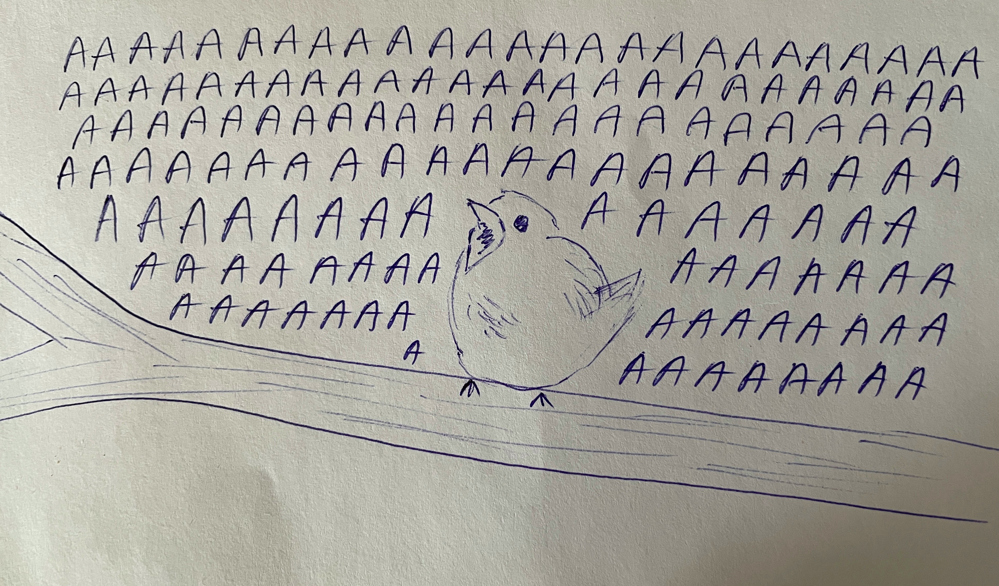

### Therapy time

Напишите здесь ваши впечатления о задании (можно и не о задании): было ли интересно, было ли слишком легко или наоборот сложно и тд. Также сюда можно написать свои идеи по улучшению заданий, а также предложить данные, на основе которых вы бы хотели построить следующие дз.

**Ваши мысли:**

*Ой, всё, короче*

*Настроение "ну это ваше машинное обучение"... Учу, учу, а они не учатся. И я, видимо, тоже недостаточно :( Наверное, надо оставить это дело профессионалам*

(на самом деле, мне правда не хватает времени обстоятельно разобраться в том, в чём хочется, поэтому пока так по верхам, и мб когда-нибудь, мб даже в скором времени для соревнования на каггле, придётся почитать умные статьи)